In [4]:
%pip install colour

Defaulting to user installation because normal site-packages is not writeable
  Using cached colour-0.1.5-py2.py3-none-any.whl (23 kB)
Note: you may need to restart the kernel to use updated packages.


In [99]:
import plotly.express as px
from training_db import get_result
import numpy as np
import torch
from toy_model import loss_fn
import tqdm.auto as tqdm
from copy import deepcopy

In [87]:
train_result = get_result("993e9bf76abc4288907ce1a9d7ee039d", load_checkpoints=True)
model = train_result.model
model.cpu()
checkpoints = train_result.checkpoints

In [127]:
x_train = train_result.train.cpu()
x_test = train_result.test.cpu()
config = train_result.config

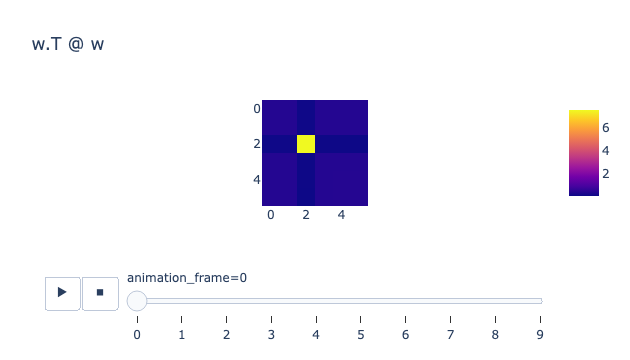

In [15]:
ims = np.empty(
    (10, model.features, model.features), dtype=np.float32
)

with torch.no_grad():
    for i, cpkt in enumerate(checkpoints[290:300]):
        model.load_state_dict(cpkt[1])
        w = model.W.numpy()
        ims[i] = w.T @ w

px.imshow(ims, animation_frame=0, title="w.T @ w")

In [27]:
model.load_state_dict(checkpoints[293][1])

<All keys matched successfully>

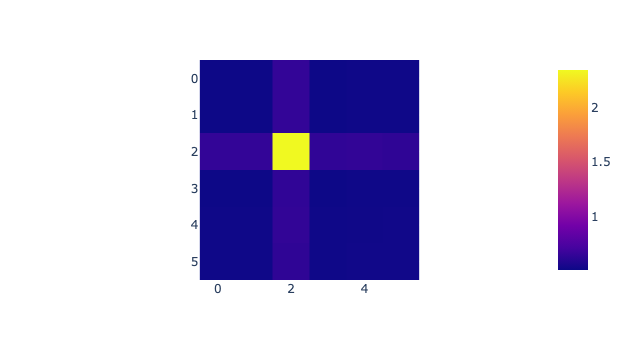

In [28]:
with torch.no_grad():
    fig = px.imshow((model.W.T @ model.W).numpy())
fig

In [32]:
model(torch.tensor([[2, 3, 0., 0., 0., 0.]]))

(tensor([[4.6620, 4.6079, 2.3438, 4.3490, 4.0558, 3.8173]],
        grad_fn=<MulBackward0>),
 0)

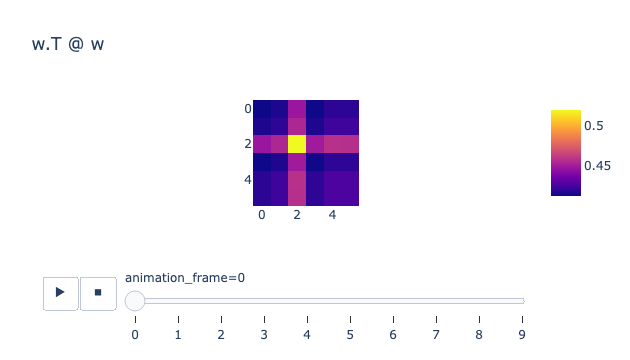

In [16]:
ims = np.empty(
    (10, model.features, model.features), dtype=np.float32
)

with torch.no_grad():
    for i, cpkt in enumerate(checkpoints[370:380]):
        model.load_state_dict(cpkt[1])
        w = model.W.numpy()
        ims[i] = w.T @ w

px.imshow(ims, animation_frame=0, title="w.T @ w")

In [48]:
model.W.device
x_train.device

device(type='cuda', index=0)

In [96]:
model.load_state_dict(checkpoints[0][1])

<All keys matched successfully>

In [97]:
optimizer = torch.optim.AdamW(model.parameters())

In [98]:
gradients = []
states = []

In [100]:
def step():
    prediction, _ = model(x_train)
    actual = abs(x_train)
    loss = loss_fn(config.i, prediction, actual)
    loss.backward()
    gradients.append(deepcopy((model.W.grad, model.b.grad)))
    states.append(deepcopy(model.state_dict()))
    optimizer.step()
    optimizer.zero_grad()

In [101]:
for i in tqdm.tqdm(range(60_000)):
    step()

  0%|          | 0/60000 [00:00<?, ?it/s]

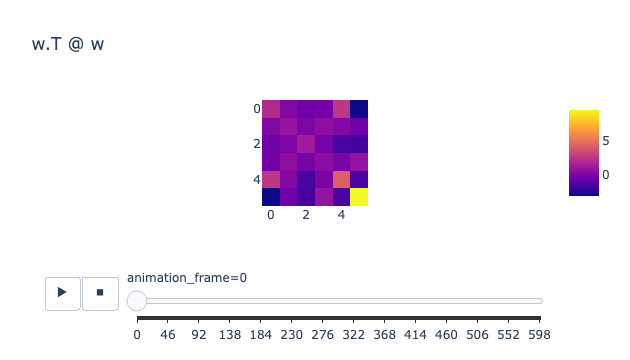

In [102]:
ims2 = np.empty(
    (600, model.features, model.features), dtype=np.float32
)

with torch.no_grad():
    # for i, state in enumerate(states[2900:3000]):
    for i in range(600):
        state = states[i * 100]
        model.load_state_dict(state)
        w = model.W.numpy()
        ims2[i] = w.T @ w

px.imshow(ims2, animation_frame=0, title="w.T @ w")

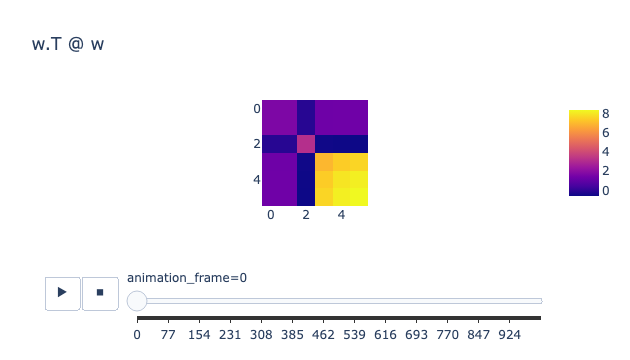

In [104]:
ims1314 = np.empty(
    (1000, model.features, model.features), dtype=np.float32
)

with torch.no_grad():
    for i in range(1000):
        state = states[13000 + i]
        model.load_state_dict(state)
        w = model.W.numpy()
        ims1314[i] = w.T @ w

px.imshow(ims1314, animation_frame=0, title="w.T @ w")

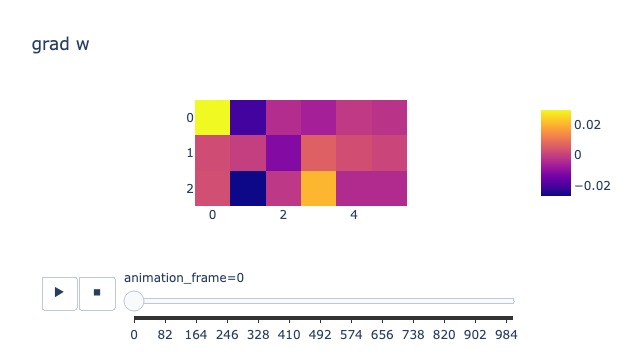

In [107]:
grad1314 = np.empty(
    (1000, model.neurons, model.features), dtype=np.float32
)

with torch.no_grad():
    for i in range(1000):
        w_grad, b_grad = gradients[13000 + i]
        grad1314[i] = w_grad

px.imshow(grad1314, animation_frame=0, title="grad w")

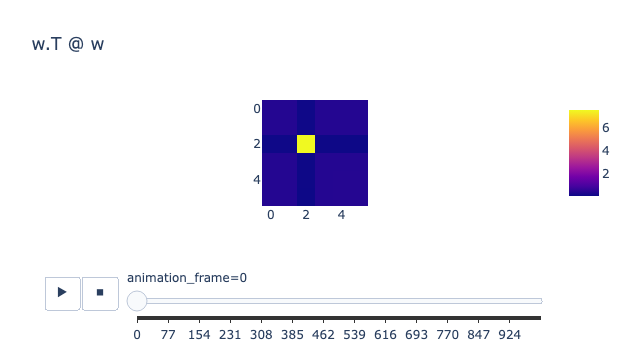

In [105]:
ims2930 = np.empty(
    (1000, model.features, model.features), dtype=np.float32
)

with torch.no_grad():
    for i in range(1000):
        state = states[29000 + i]
        model.load_state_dict(state)
        w = model.W.numpy()
        ims2930[i] = w.T @ w

px.imshow(ims2930, animation_frame=0, title="w.T @ w")

In [109]:
model.W.shape

torch.Size([3, 6])

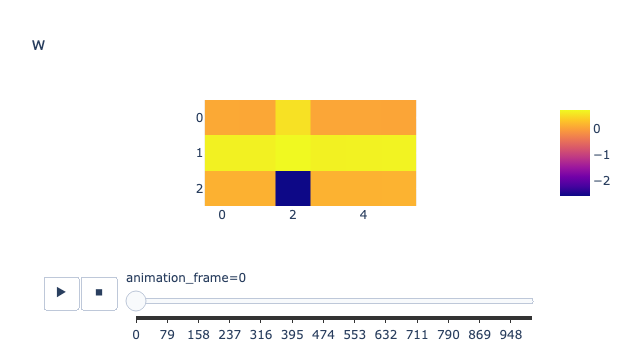

In [110]:
ims2930 = np.empty(
    (1000, model.neurons, model.features), dtype=np.float32
)

with torch.no_grad():
    for i in range(1000):
        state = states[29000 + i]
        model.load_state_dict(state)
        ims2930[i] = model.W.numpy()

px.imshow(ims2930, animation_frame=0, title="w")

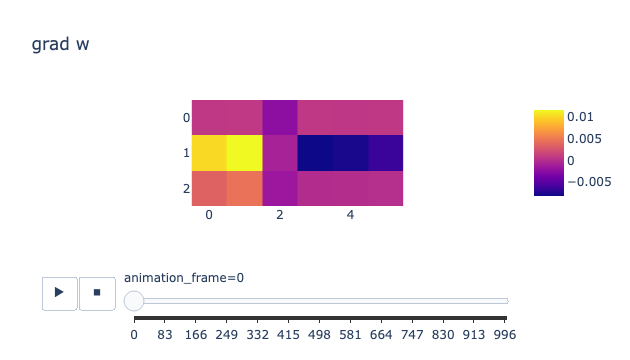

In [108]:
grad2930 = np.empty(
    (1000, model.neurons, model.features), dtype=np.float32
)

with torch.no_grad():
    for i in range(1000):
        w_grad, b_grad = gradients[29000 + i]
        grad2930[i] = w_grad

px.imshow(grad2930, animation_frame=0, title="grad w")

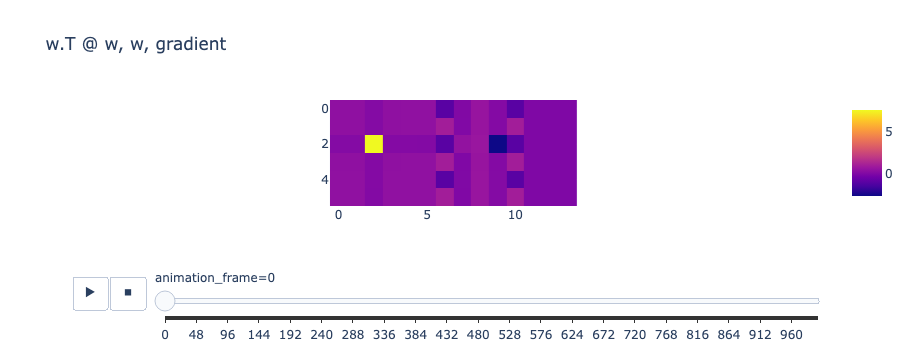

In [118]:
imgrad2930 = np.zeros(
    (1000, 2 * model.neurons + model.features + 2, model.features), dtype=np.float32
)

separator = np.array([-1, 1, -1, 1, -1, 1])

with torch.no_grad():
    for i in range(1000):
        state = states[29000 + i]
        model.load_state_dict(state)
        w = model.W.numpy()
        
        imgrad2930[i, :model.features] = w.T @ w
        
        imgrad2930[i, model.features] = separator
        
        imgrad2930[i, (model.features + 1):(model.features + model.neurons + 1)] = w
        
        imgrad2930[i, model.features + model.neurons + 1] = separator
        
        w_grad, b_grad = gradients[29000 + i]
        imgrad2930[i, (model.features + model.neurons + 2):] = w_grad

px.imshow(imgrad2930.transpose(0, 2, 1), animation_frame=0, title="w.T @ w, w, gradient")

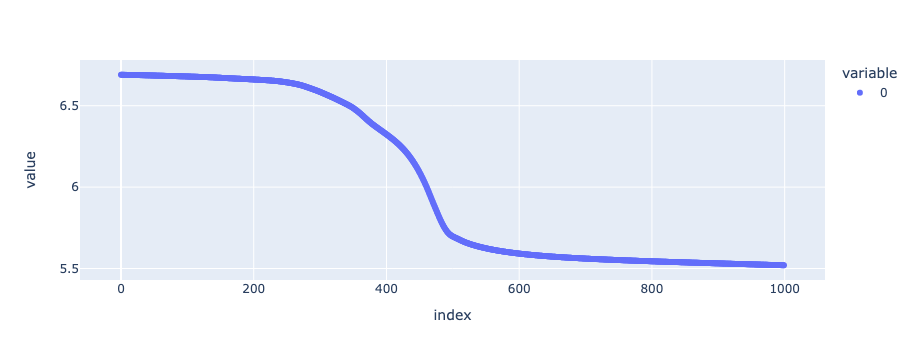

In [124]:
losses = train_result.losses
px.scatter(losses[29_000: 30_000])

In [125]:
model29 = deepcopy(model)
model30 = deepcopy(model)

In [126]:
model29.load_state_dict(checkpoints[290][1])
model30.load_state_dict(checkpoints[300][1])

<All keys matched successfully>

In [128]:
train_actual = abs(x_train)
test_actual = abs(x_test)

with torch.no_grad():
    train29, _ = model29(x_train)
    test29, _ = model29(x_test)
    train30, _ = model30(x_train)
    test30, _ = model30(x_test)
    
    loss_train29 = loss_fn(config.i, train29, train_actual)
    loss_test29 = loss_fn(config.i, test29, test_actual)
    loss_train30 = loss_fn(config.i, train30, train_actual)
    loss_test30 = loss_fn(config.i, test30, test_actual)
    print(f'29: {loss_train29}, {loss_test29}')
    print(f'30: {loss_train30}, {loss_test30}')

29: 6.690349102020264, 6.650118350982666
30: 5.519937992095947, 5.541964530944824


In [143]:
importance = config.i
features = 6

In [148]:
error29 = train29 - train_actual
importance29 = torch.tensor([importance**i for i in range(features)])
print((error29**2 * importance29).shape)
errors29 = torch.mean(error29**2 * importance, axis=1)

torch.Size([8096, 6])


In [155]:
topk29 = errors29.topk(10)
print(topk29.values)

tensor([25.8343, 25.0016, 24.5393, 24.4882, 24.4694, 23.7983, 23.5340, 23.4791,
        23.2297, 22.8862])


In [159]:
train29[topk29.indices]

tensor([[ 4.9617e+00,  4.8675e+00, -2.0569e-34,  5.0209e+00,  5.1117e+00,
          5.3522e+00],
        [ 3.2017e+00,  2.9692e+00,  8.6849e+00,  2.6315e+00,  2.4019e+00,
          2.1394e+00],
        [ 4.9090e+00,  4.8315e+00, -1.5285e-23,  4.8272e+00,  4.7165e+00,
          4.7489e+00],
        [ 4.9349e+00,  4.8500e+00, -2.3643e-28,  4.9149e+00,  4.8909e+00,
          5.0109e+00],
        [ 4.9401e+00,  4.8536e+00, -1.9803e-29,  4.9341e+00,  4.9300e+00,
          5.0706e+00],
        [ 3.1042e+00,  3.1081e+00,  7.3923e+00,  2.9196e+00,  2.6005e+00,
          2.4187e+00],
        [ 4.9311e+00,  4.8474e+00, -1.3241e-27,  4.9015e+00,  4.8637e+00,
          4.9697e+00],
        [ 4.9430e+00,  4.8555e+00, -4.8222e-30,  4.9450e+00,  4.9523e+00,
          5.1048e+00],
        [ 4.9550e+00,  4.8634e+00, -9.0608e-33,  4.9926e+00,  5.0516e+00,
          5.2583e+00],
        [ 4.9522e+00,  4.8616e+00, -4.2860e-32,  4.9809e+00,  5.0270e+00,
          5.2201e+00]])

In [156]:
error30 = train30 - train_actual
importance30 = torch.tensor([importance**i for i in range(features)])
print((error30**2 * importance30).shape)
errors30 = torch.mean(error30**2 * importance, axis=1)

torch.Size([8096, 6])


In [157]:
topk30 = errors30.topk(10)
print(topk30.values)

tensor([23.1316, 20.9999, 20.8787, 19.8447, 19.7086, 19.6268, 19.4642, 19.3679,
        19.3331, 19.1320])


In [158]:
train30[topk30.indices]

tensor([[4.2482, 4.0952, 3.6772, 3.7193, 3.2919, 2.9883],
        [4.2467, 4.0939, 3.6794, 3.7196, 3.2940, 2.9911],
        [4.2480, 4.0951, 3.6774, 3.7193, 3.2921, 2.9886],
        [4.2268, 4.1529, 4.2556, 3.7682, 3.4072, 3.1067],
        [4.2453, 4.0928, 3.6814, 3.7199, 3.2958, 2.9936],
        [4.2081, 4.0493, 3.6224, 3.6766, 3.2450, 2.9420],
        [4.2439, 4.0899, 3.6718, 3.7183, 3.2942, 2.9924],
        [4.2450, 4.0924, 3.6820, 3.7200, 3.2963, 2.9942],
        [4.2450, 4.0925, 3.6818, 3.7199, 3.2962, 2.9941],
        [4.2366, 4.0722, 3.5978, 3.7029, 3.2708, 2.9691]])

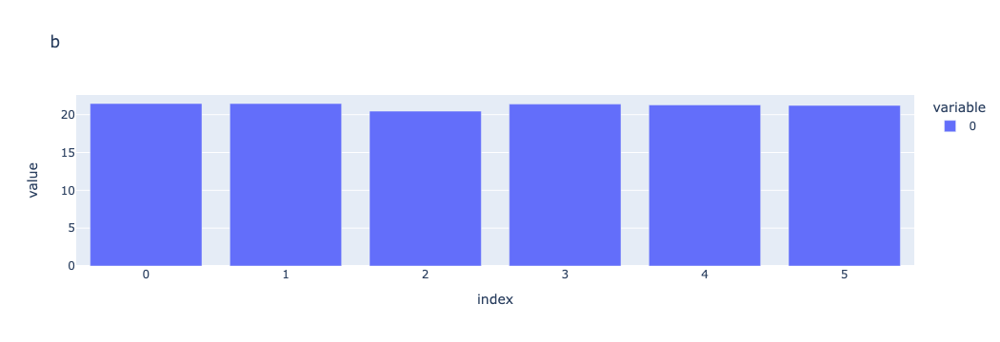

In [163]:
biases = np.empty((1000, model.features), dtype=np.float32)

with torch.no_grad():
    # for i, state in enumerate(states[2900:3000]):
    for i in range(1000):
        state = states[29_000 + i]
        model.load_state_dict(state)
        b = model.b.numpy()
        biases[i] = b

# px.bar(biases, animation_frame=0, title="b")
px.bar(biases[0], title="b")

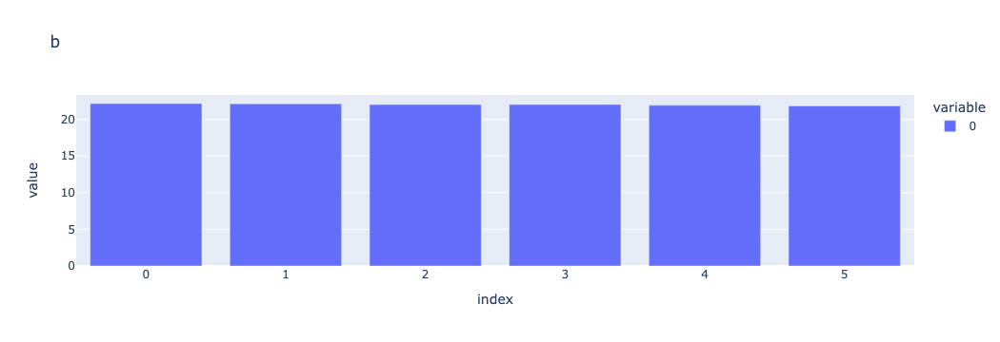

In [164]:
px.bar(biases[-1], title="b")

In [165]:
small_value_t = torch.tensor([[ 4.9617e+00,  4.8675e+00, -2.0569e-34,  5.0209e+00,  5.1117e+00, 5.3522e+00]])

In [172]:
model29(train29[topk29.indices])[0].detach().numpy()

array([[5.387779 , 5.4338098, 5.5258794, 5.1531982, 5.3801136, 5.3340335],
       [5.3375134, 5.373644 , 4.917804 , 5.0886965, 5.232445 , 5.153279 ],
       [5.364104 , 5.4051576, 5.211781 , 5.122264 , 5.3069105, 5.243864 ],
       [5.3750167, 5.4182763, 5.3493853, 5.136377 , 5.339692 , 5.284113 ],
       [5.377361 , 5.4211164, 5.3804717, 5.139437 , 5.3469415, 5.2930493],
       [5.3240886, 5.3579535, 4.7845483, 5.0721297, 5.1970134, 5.1104884],
       [5.373366 , 5.4162827, 5.327853 , 5.134225 , 5.3346386, 5.2778955],
       [5.3786817, 5.422724 , 5.3982253, 5.141172 , 5.3510547, 5.2981234],
       [5.384422 , 5.4297013, 5.477623 , 5.148734 , 5.3692365, 5.320567 ],
       [5.383017 , 5.428008 , 5.457896 , 5.146877 , 5.3647532, 5.3150144]],
      dtype=float32)

In [173]:
model30(train29[topk29.indices])[0].detach().numpy()

array([[6.566673 , 6.1646466, 2.98584  , 6.3291535, 6.4729605, 6.639955 ],
       [4.6669416, 5.0658746, 8.653048 , 4.753522 , 5.0872817, 4.9575877],
       [6.424567 , 6.063099 , 3.1312187, 6.17403  , 6.2797375, 6.3959093],
       [6.4876294, 6.108517 , 3.0669212, 6.2428465, 6.3653235, 6.5036116],
       [6.5016875, 6.1185794, 3.052516 , 6.258229 , 6.3844566, 6.5277615],
       [4.8999944, 5.209964 , 7.559502 , 4.9301744, 5.2092886, 5.089863 ],
       [6.4778304, 6.1015034, 3.0769167, 6.2321854, 6.35204  , 6.486836 ],
       [6.5096965, 6.1242776, 3.044325 , 6.2669535, 6.3953605, 6.541549 ],
       [6.545261 , 6.1495304, 3.007843 , 6.3057756, 6.443777 , 6.6028533],
       [6.536446 , 6.1433077, 3.016877 , 6.2961626, 6.4317884, 6.587679 ]],
      dtype=float32)